First, load dependencies. 

In [56]:
import sys
sys.path.append("./")
import pandas as pd
import numpy as np
from settings import settings, paths
import os
import muffin
import scanpy as sc

In [57]:
# Avoids warning spam
os.environ['PYTHONWARNINGS']='ignore'

You can set plot settings for muffin :

In [58]:
muffin.params["autosave_plots"] = "10k_pbmcs_results/"
muffin.params["figure_dpi"] = 300
muffin.params["autosave_format"] = ".pdf"
sc.set_figure_params(dpi=500, dpi_save=500)
sc.set_figure_params(dpi=500, dpi_save=500)
sc.settings.autosave = True
sc.settings.figdir = "10k_pbmcs_results/"
# Makes pdf font editable with pdf editors
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42

We can load the dataset using scanpy functions, however muffin does not support sparse matrices :

In [59]:
dataset = sc.read_10x_mtx(paths.scRNAseqGenes)
dataset.X = dataset.X.astype(np.int32).toarray()

The dataset is in an anndata object, which allows for an easy annotation of the count matrix, and the storage of different count transforms. Results will be stored in this object.

In [60]:
print(dataset)

AnnData object with n_obs × n_vars = 11996 × 36601
    var: 'gene_ids', 'feature_types'


Here, we perform some standard QC (counts, percentage of mitochondrial RNA, number of detected genes...) on cells to remove low quality cells.

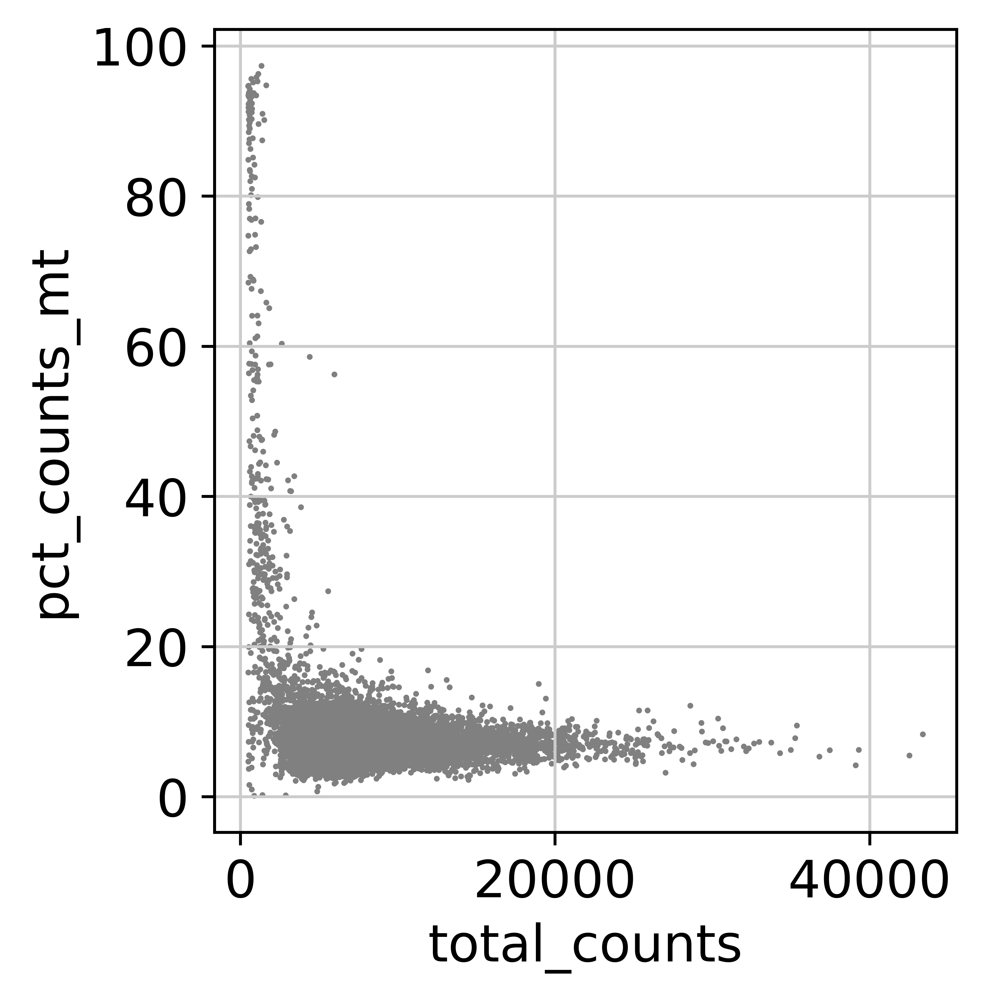

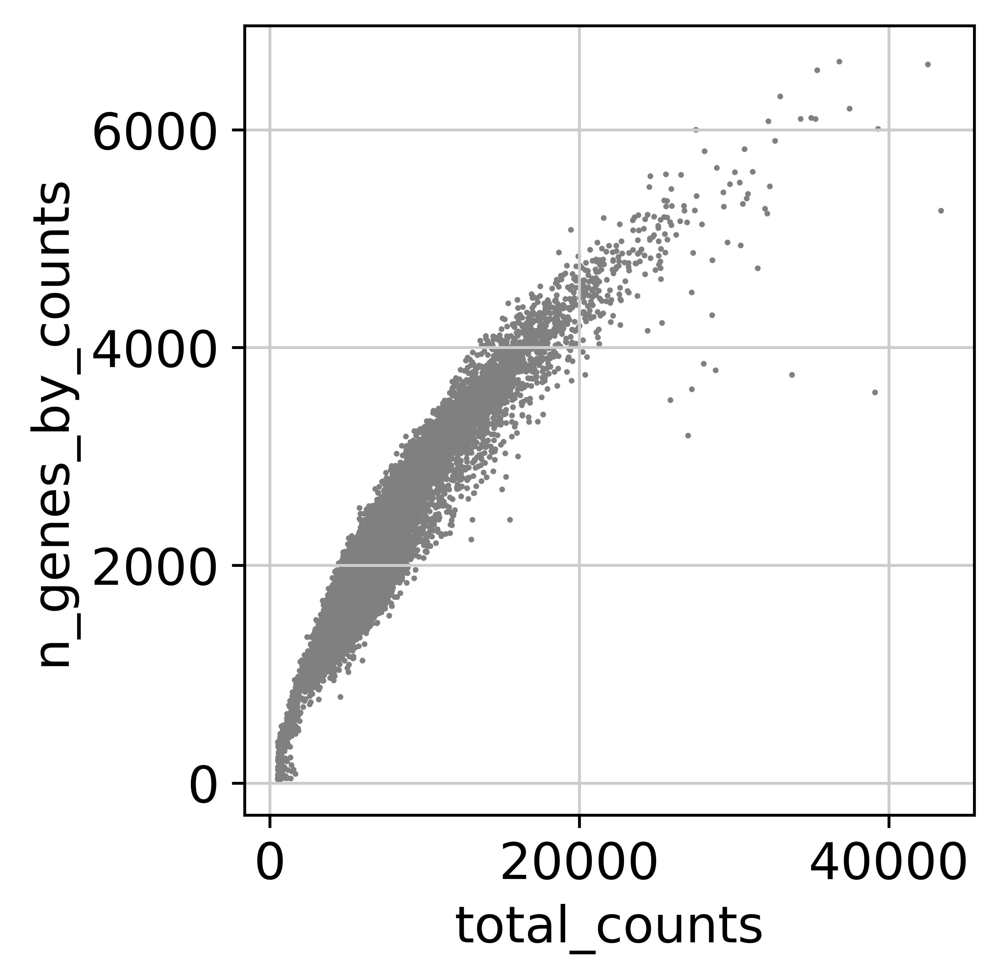

In [61]:
dataset.var['mt'] = dataset.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(dataset, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(dataset, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(dataset, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(dataset, x='total_counts', y='n_genes_by_counts')
dataset = dataset[dataset.obs.pct_counts_mt < 15, :]
dataset = dataset[dataset.obs.n_genes_by_counts < 4000, :]
dataset = dataset[dataset.obs.n_genes_by_counts > 1000, :]

Here, we set up the design matrix of the linear model. If you do not want to regress any confounding factors leave it to a column array of ones as in the example. Note that it can have a tendency to "over-regress" and remove biological signal as it is a simple linear correction.

In [62]:
design = np.ones((dataset.X.shape[0],1))
muffin.load.set_design_matrix(dataset, design)

Now, we are going to normalize library sizes using the scran approach, which is well suited to a large number of observations and small counts with many zeroes. We are also going to remove features with very low signal (note that this is mandatory to remove all zero counts).

In [63]:
muffin.tools.compute_size_factors(dataset, method="scran")
detectable = muffin.tools.trim_low_counts(dataset)
dataset = dataset[:, detectable]

The next step is to fit the mean-variance relationship and compute residuals to the fitted Negative Binomial model.

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done 248 tasks      | elapsed:   52.4s
[Parallel(n_jobs=16)]: Done 2000 out of 2000 | elapsed:  1.5min finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done 9248 tasks      | elapsed:   53.2s
[Parallel(n_jobs=16)]: Done 21040 tasks      | elapsed:  1.1min
[Parallel(n_jobs=16)]: Done 21890 out of 21890 | elapsed:  1.2min finished


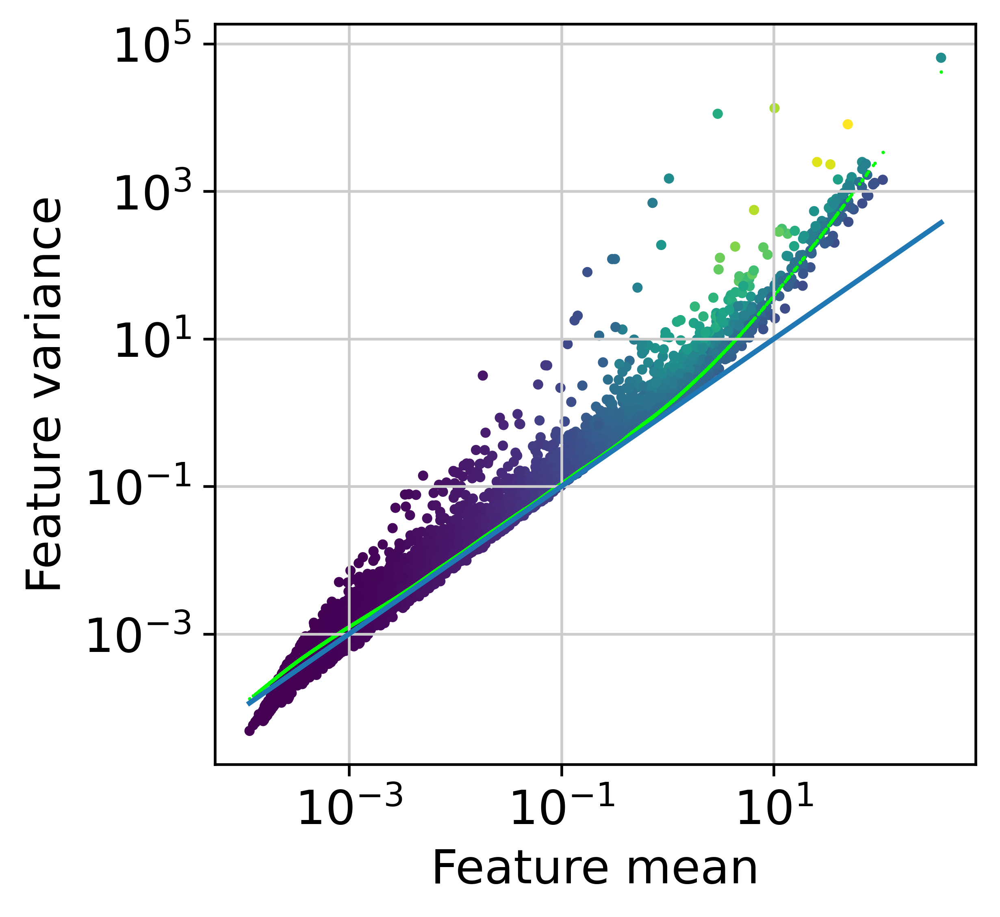

AnnData object with n_obs × n_vars = 10877 × 21890
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'size_factors'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'means', 'variances', 'reg_alpha'
    obsm: 'design'
    layers: 'residuals'

In [64]:
muffin.tools.compute_residuals(dataset, maxThreads=16)

We can perform feature selection to remove peaks with low information.

<Figure size 1200x1200 with 0 Axes>

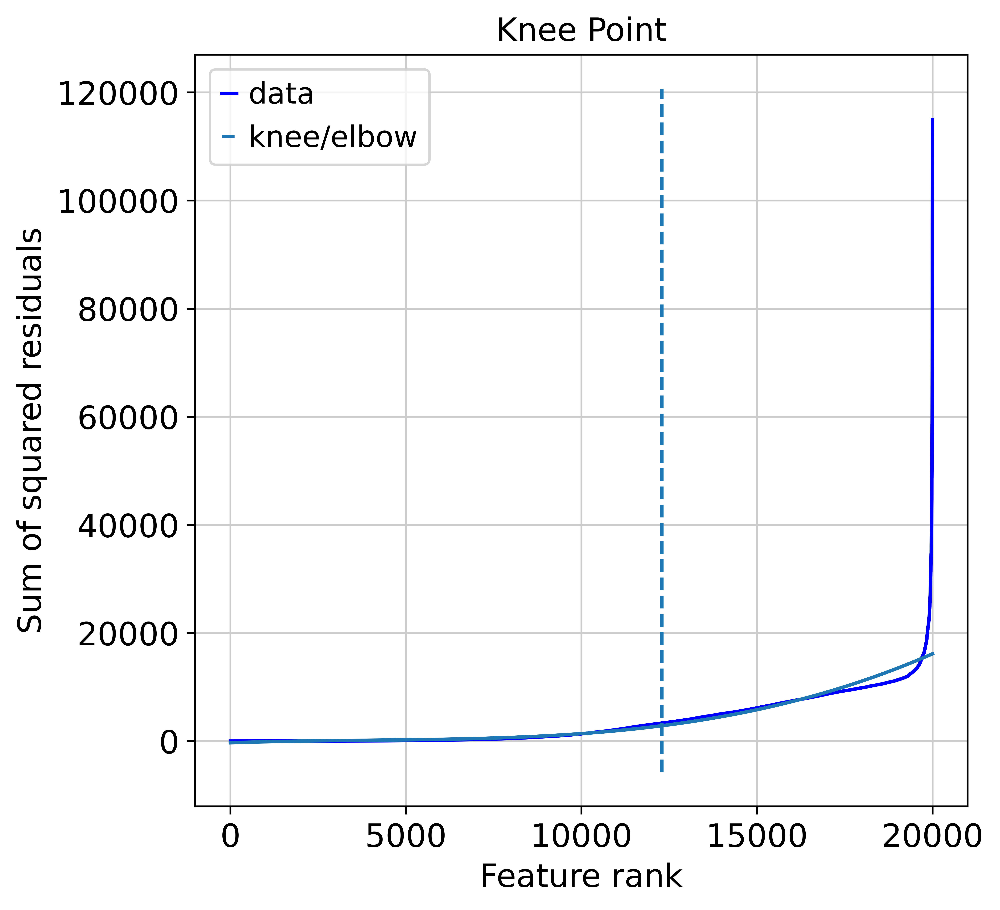

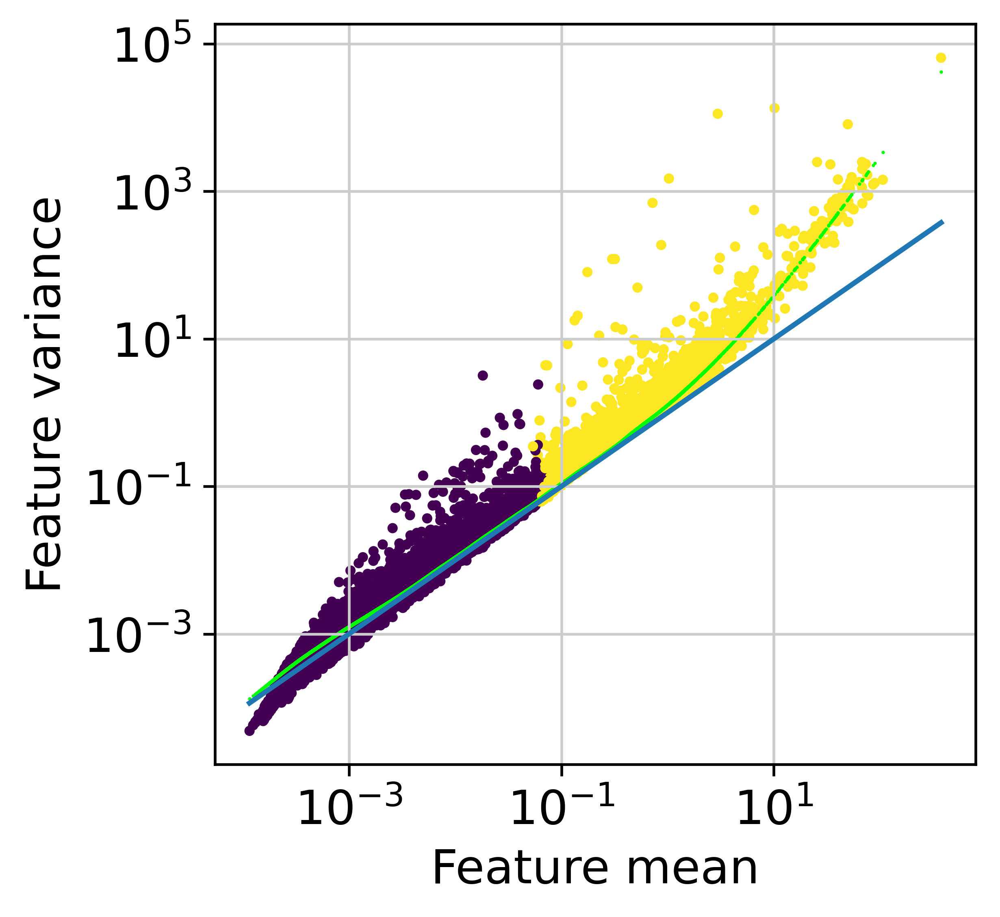

In [65]:
hv = muffin.tools.feature_selection_elbow(dataset)

Next, we perform dimensionnality reduction with PCA (automatically finding the optimal dimensionnality) and UMAP.

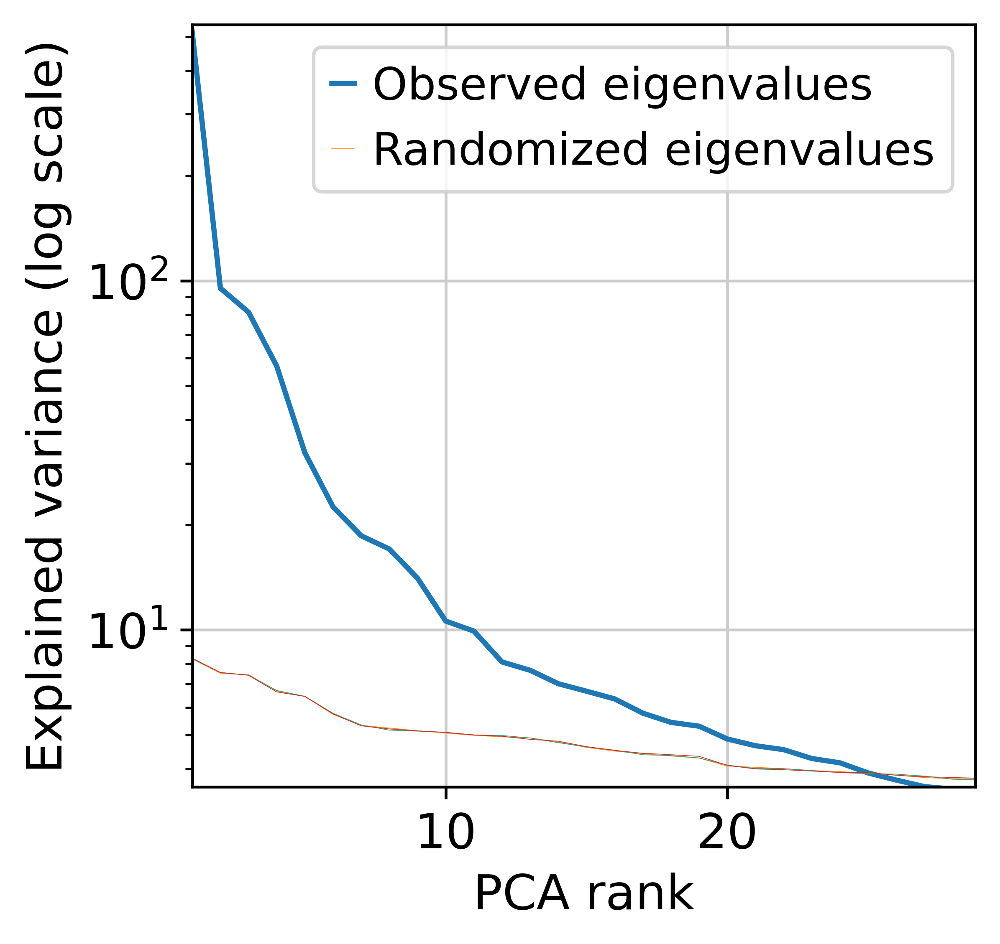

AnnData object with n_obs × n_vars = 10877 × 21890
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'size_factors'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'means', 'variances', 'reg_alpha'
    uns: 'pca'
    obsm: 'design', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'residuals'

In [66]:
muffin.tools.compute_pa_pca(dataset, feature_mask=hv, max_rank=100, plot=True)
muffin.tools.compute_umap(dataset)

Now, cluster the cells.

In [67]:
muffin.tools.cluster_rows_leiden(dataset)

32


AnnData object with n_obs × n_vars = 10877 × 21890
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'size_factors', 'leiden'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'means', 'variances', 'reg_alpha'
    uns: 'pca'
    obsm: 'design', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'residuals'

Display the results. Note that we can use scanpy functions here!

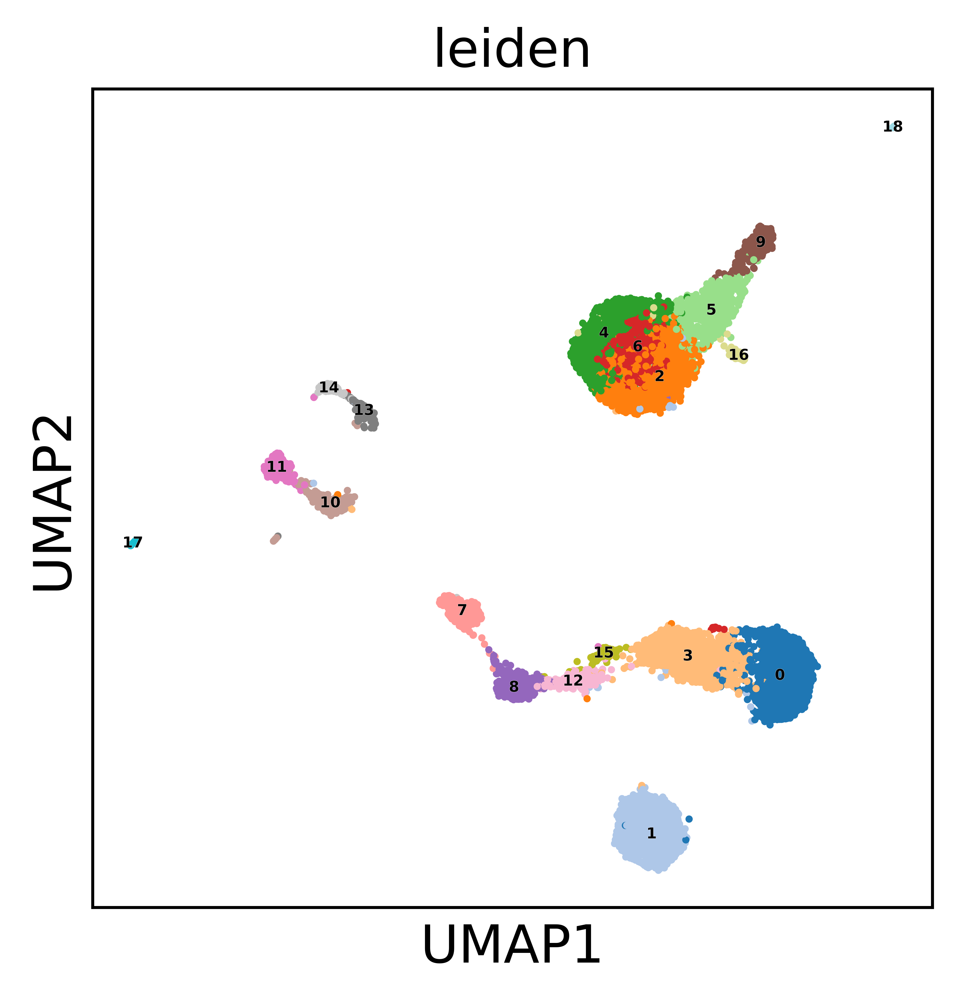

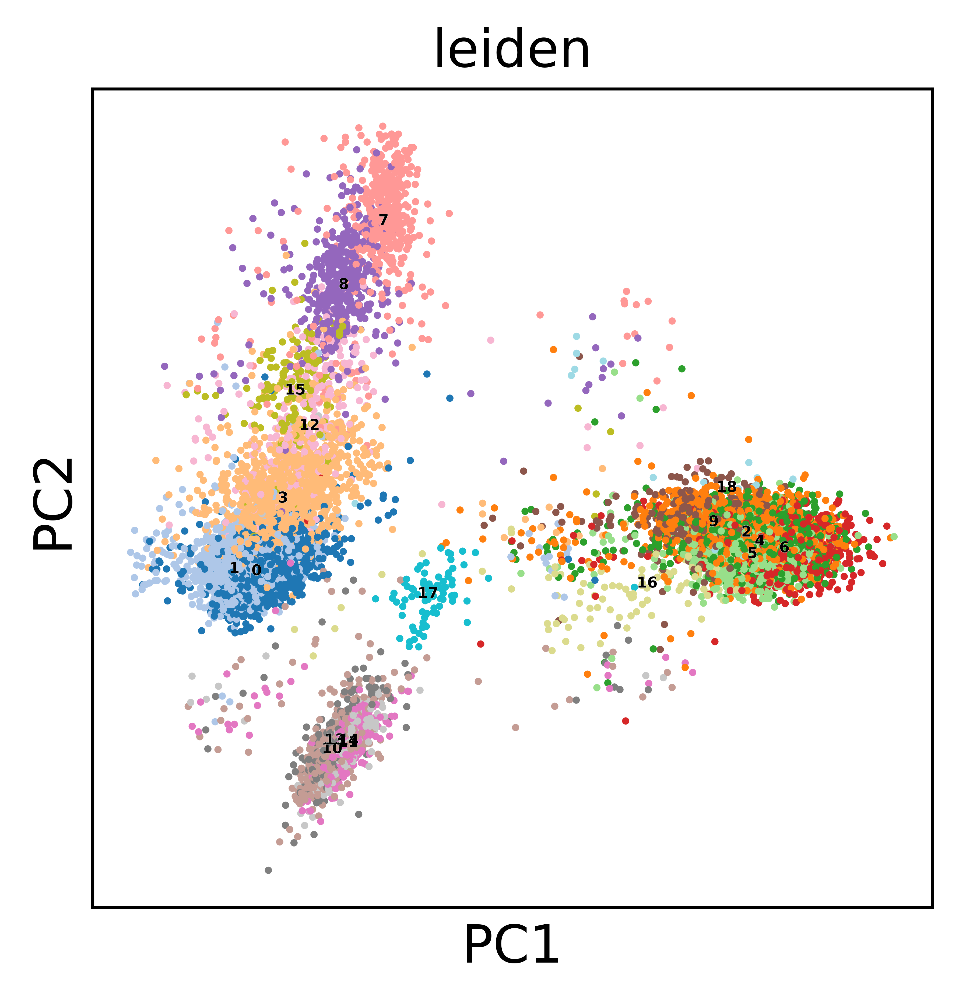

In [68]:
# Append cell type info to the dataset
sc.pl.umap(dataset, color='leiden', legend_loc='on data',
                legend_fontsize=4, legend_fontoutline=0.1, s=15.0,
                palette='tab20')
sc.pl.pca(dataset, color='leiden', legend_loc='on data',
                legend_fontsize=4, legend_fontoutline=0.1, s=15.0,
                palette='tab20')

We can also use heatmaps, even if we have a large number of observations and features :

In [69]:
# fig, ax = muffin.plots.mega_heatmap(dataset[:, hv], method="average", metric="correlation", layer="residuals", label_col="leiden", vmin=-3, vmax=3)

Let's find markers using a logistic regression :

In [70]:
from sklearn.preprocessing import StandardScaler
# It is strongly advised to standardize inputs for a better convergence of the solver (especially for large datasets).
dataset.layers["scaled"] = StandardScaler().fit_transform(dataset.layers["residuals"])
sc.tl.rank_genes_groups(dataset, 'leiden', use_raw=False, layer="scaled",
                        method='logreg', class_weight="balanced")

We can see some known markers of well-known cell types (CD8A for cluster 2 - CD8+ T Cells, PPBP for cluster 17 - platelets):

In [71]:
sc.pl.rank_genes_groups(dataset, sharey=False)

Let's annotate cell types :

In [72]:
cluster_names = {"0":"T-Cells CD4 Naive ",
                 "1":"T-Cells CD8 Naive ",
                 "2":"Monocytes",
                 "3":"T-Cells CD4 Memory",
                 "4":"Monocytes CES1+",
                 "5":"Monocytes APOBEC3A+",
                 "6":"Monocytes MX1+",
                 "7":"NK Cells",
                 "8":"T-Cells CD8 GZMH+",
                 "9":"Monocytes FCGR3A+",
                 "10":"B-Cells IGKC+",
                 "11":"B-Cells IGKC+ TCL1A+",
                 "12":"T-Cells CD8 GZMK+",
                 "13":"B-Cells IGLC2+",
                 "14":"B-Cells IGLC2+ TCL1A+",
                 "15":"T-Cells MAIT",
                 "16":"Myeloid DC",
                 "17":"Plasmacytoid DC",
                 "18":"Platelets"}
dataset.obs["Annotated clusters"] = pd.Series(cluster_names)[dataset.obs["leiden"]].values

We can have a look at the monocyte subtype markers, which do not seem to be hallucinated as they correspond to specific markers. 
This also highlights the effectiveness of the logistic regression for that purpose, which finds highly specific markers for each cluster due to its multivariate nature.

In [73]:
sc.pl.umap(dataset, color=["CES1", "APOBEC3A", "MX1", "FCGR3A"], legend_loc='on data',
                legend_fontsize=4, legend_fontoutline=0.1, s=15.0,
                palette='tab20', layer="residuals", vmax=5, save=f"umap_monocyte_markers.pdf")

We can re-plot with annotated clusters

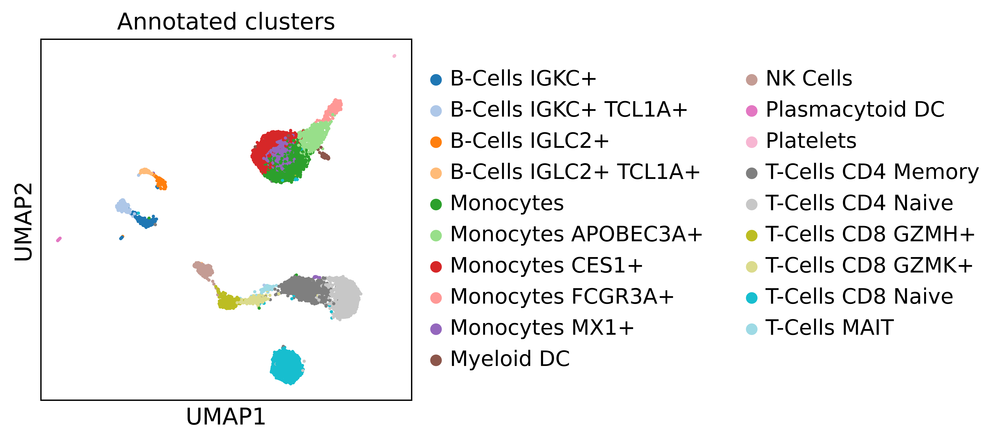

In [74]:
sc.set_figure_params(dpi=500, dpi_save=500)
sc.pl.umap(dataset, color="Annotated clusters",  s=15.0,
                palette='tab20', layer="residuals", vmax=5, save=f"umap_annot.pdf")

In [75]:
from sklearn.preprocessing import StandardScaler
# It is strongly advised to standardize inputs for a better convergence of the solver (especially for large datasets).
dataset.layers["scaled"] = StandardScaler().fit_transform(dataset.layers["residuals"])
sc.tl.rank_genes_groups(dataset, 'Annotated clusters', use_raw=False, layer="scaled",
                        method='logreg', class_weight="balanced")
# Ugly hack to solve an issue with scanpy logreg that does not output all fields
dataset.uns["rank_genes_groups"]["logfoldchanges"] = dataset.uns["rank_genes_groups"]["scores"]
dataset.uns["rank_genes_groups"]["pvals"] = dataset.uns["rank_genes_groups"]["scores"]
dataset.uns["rank_genes_groups"]["pvals_adj"] = dataset.uns["rank_genes_groups"]["scores"]
sc.pl.rank_genes_groups_heatmap(dataset, layer="residuals", use_raw=False, 
                                vmin=-3, vmax=3, cmap="vlag", show_gene_labels=True,
                                n_genes=4)

We can save our work to avoid recomputing everything. It can easily be re-loaded using :  anndata.read_h5ad(path). We can also see that our dataset carries much more data than at the start.

In [76]:
dataset.write("10k_pbmcs_results/dataset.h5ad")
print(dataset)

AnnData object with n_obs × n_vars = 10877 × 21890
    obs: 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'size_factors', 'leiden', 'Annotated clusters'
    var: 'gene_ids', 'feature_types', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'means', 'variances', 'reg_alpha'
    uns: 'pca', 'leiden_colors', 'rank_genes_groups', 'Annotated clusters_colors', 'dendrogram_Annotated clusters'
    obsm: 'design', 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'residuals', 'scaled'


Compare with SCTransform clustering

In [77]:
dataset.obs["SCTransform_clusters"] = pd.read_csv("10k_pbmcs_results/cluster_labels.csv", index_col=0)["x"]

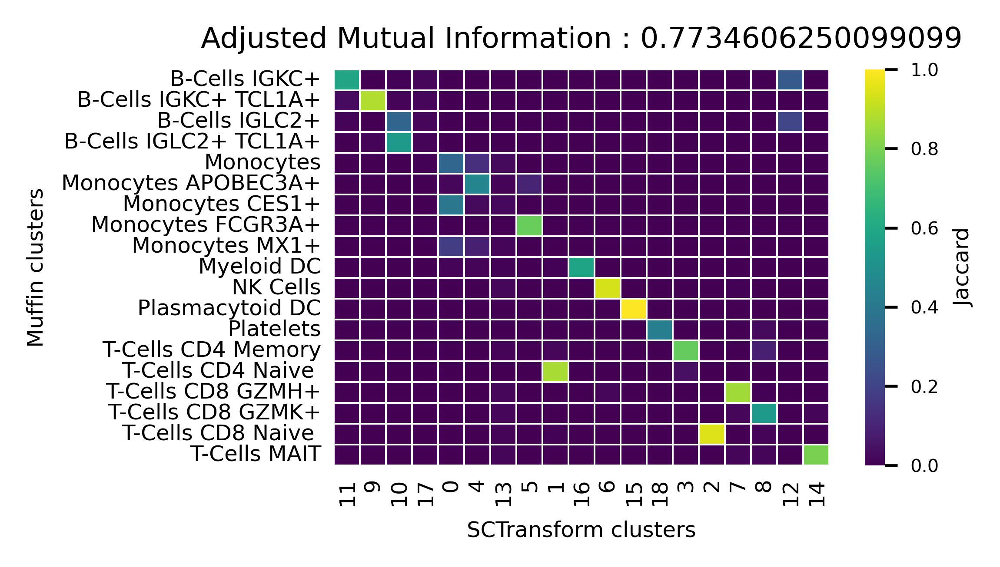

In [78]:
from sklearn.metrics import adjusted_mutual_info_score
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.spatial.distance import jaccard
# Build confusion matrix
unique_clust_muffin = np.unique(dataset.obs["Annotated clusters"])
unique_clust_sct = np.unique(dataset.obs["SCTransform_clusters"])
cm = pd.DataFrame(np.zeros((len(unique_clust_sct), len(unique_clust_muffin))), 
                  columns=unique_clust_muffin, index=unique_clust_sct)
for i in unique_clust_muffin:
    for j in unique_clust_sct:
        cm.loc[j,i] = 1-jaccard(dataset.obs["Annotated clusters"].values==i, 
                              dataset.obs["SCTransform_clusters"].values==j)
ami = adjusted_mutual_info_score(dataset.obs["Annotated clusters"].values, dataset.obs["SCTransform_clusters"].values)
# Greedily re-order cluster to match muffin clustering
orderlist = list(np.copy(unique_clust_sct))
reordered = []
for c in cm.columns:
    reordered.append(cm.loc[orderlist,c].idxmax())
    orderlist.remove(cm.loc[orderlist,c].idxmax())
# Plot
plt.figure(dpi=300, figsize=(3.5,2))
ax=sns.heatmap(cm.loc[reordered].T, xticklabels=True, yticklabels=True, 
            cbar_kws={'label': 'Jaccard'},cmap="viridis", linecolor="w", linewidths=0.25)
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=5)     
ax.figure.axes[-1].yaxis.label.set_size(6)       
plt.ylabel('Muffin clusters',fontsize=6)
plt.xlabel('SCTransform clusters',fontsize=6)
plt.yticks(fontsize=6)
plt.xticks(fontsize=6, rotation=90)
plt.grid(False)
plt.title(f"Adjusted Mutual Information : {ami}", fontsize=8)
plt.gca().set_aspect(1/1.25)
ax.tick_params(axis=u'both', which=u'both',length=0)
plt.savefig("10k_pbmcs_results/cluster_sim.pdf", bbox_inches="tight")
plt.show()

Experiment with residual type and clipping

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   31.4s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   37.8s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   44.0s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   30.8s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   39.5s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   47.0s finished


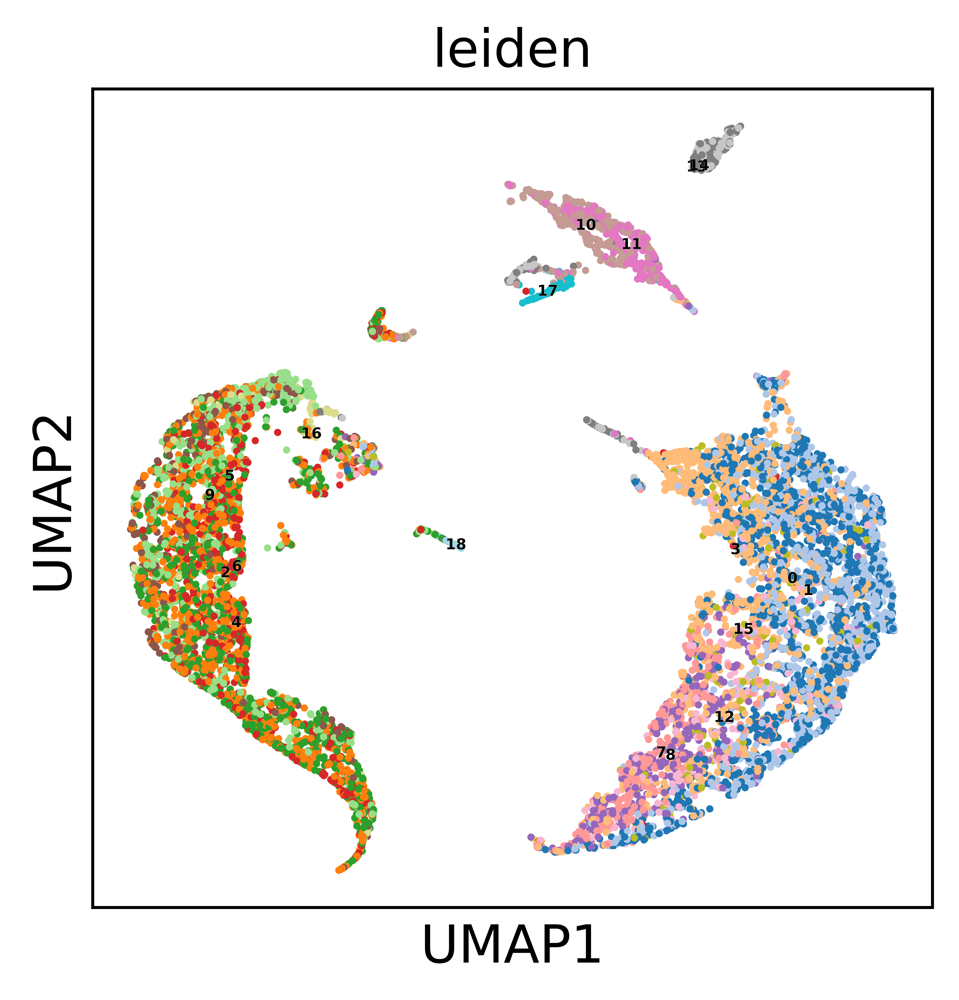

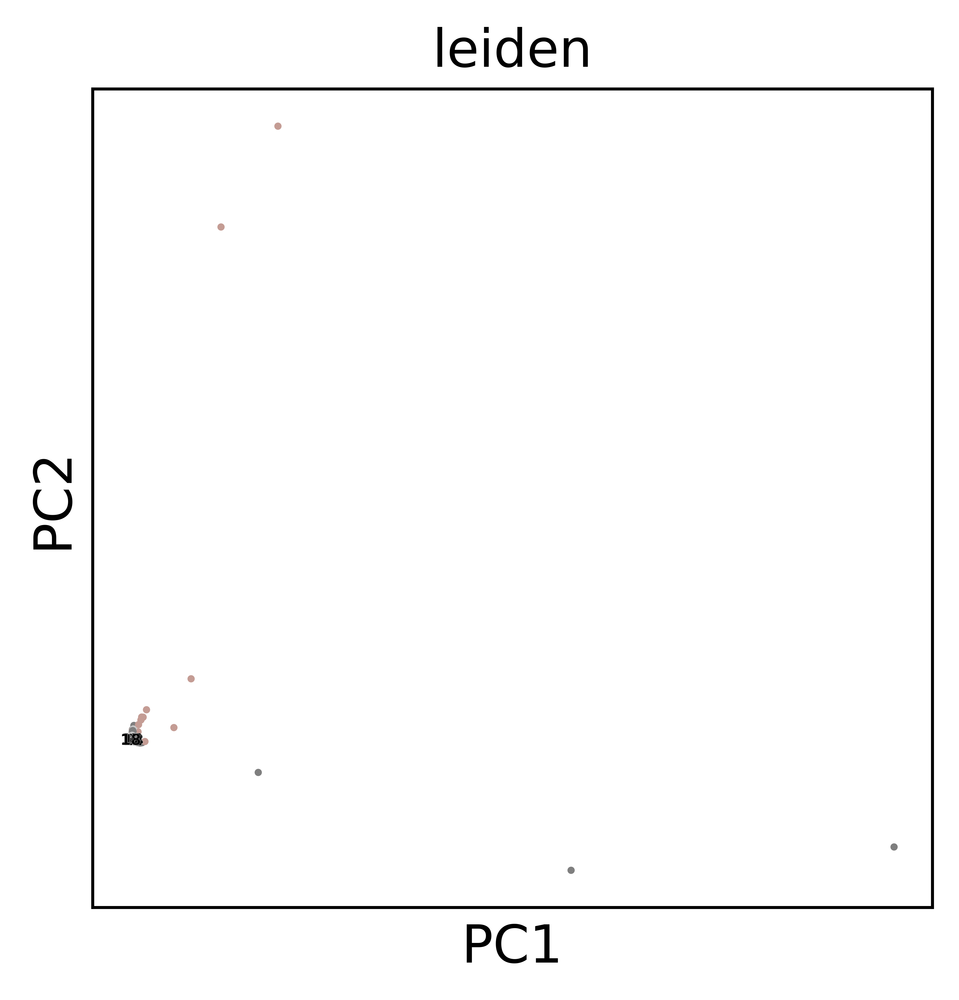

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   31.7s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   37.7s
[Parallel(n_jobs=-1)]: Done 1889 out of 2000 | elapsed:   43.4s remaining:    2.5s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   44.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   31.6s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   41.6s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   50.2s finished


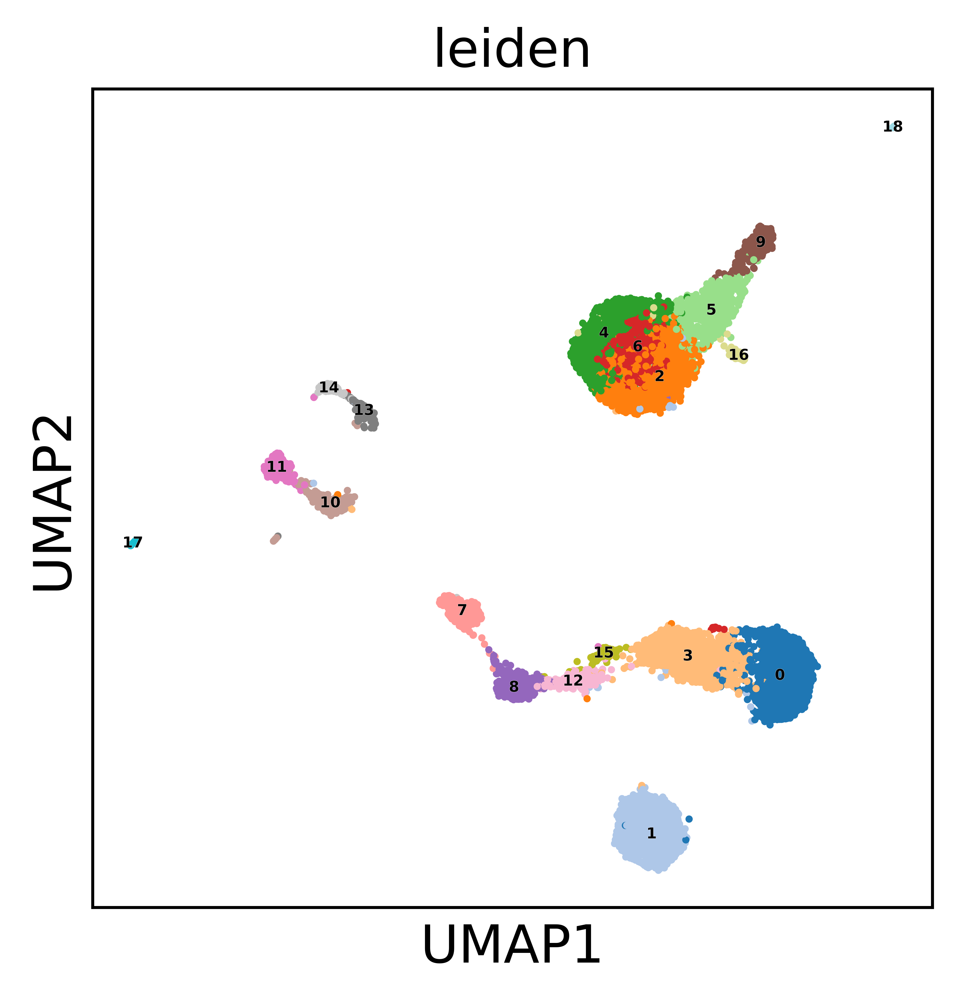

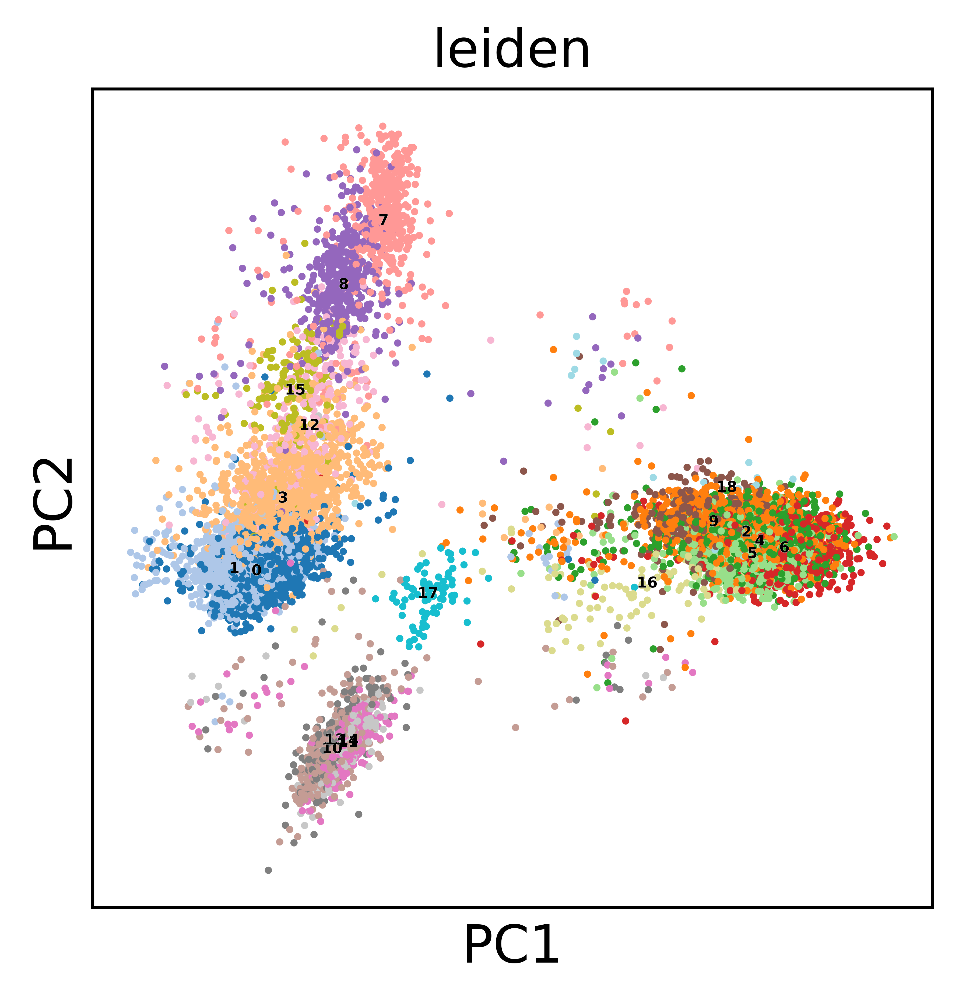

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   31.5s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   37.4s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   43.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   31.0s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   39.6s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   47.1s finished


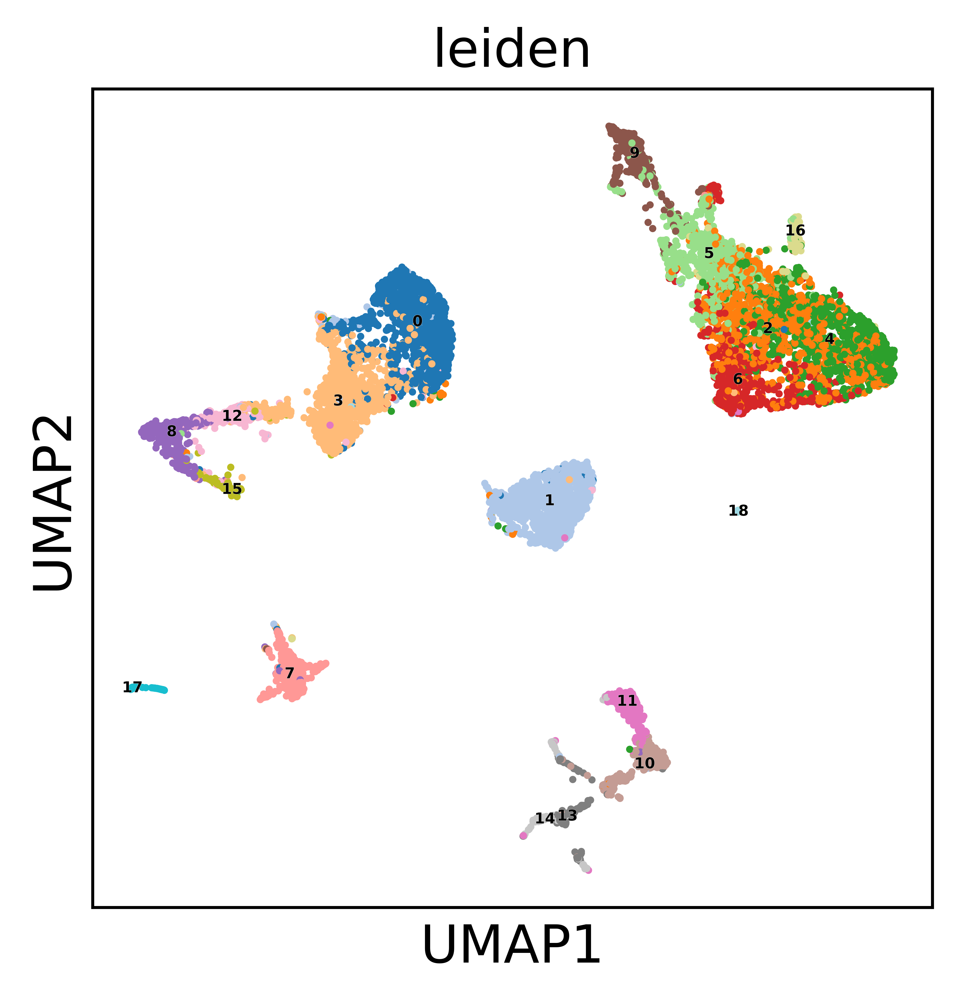

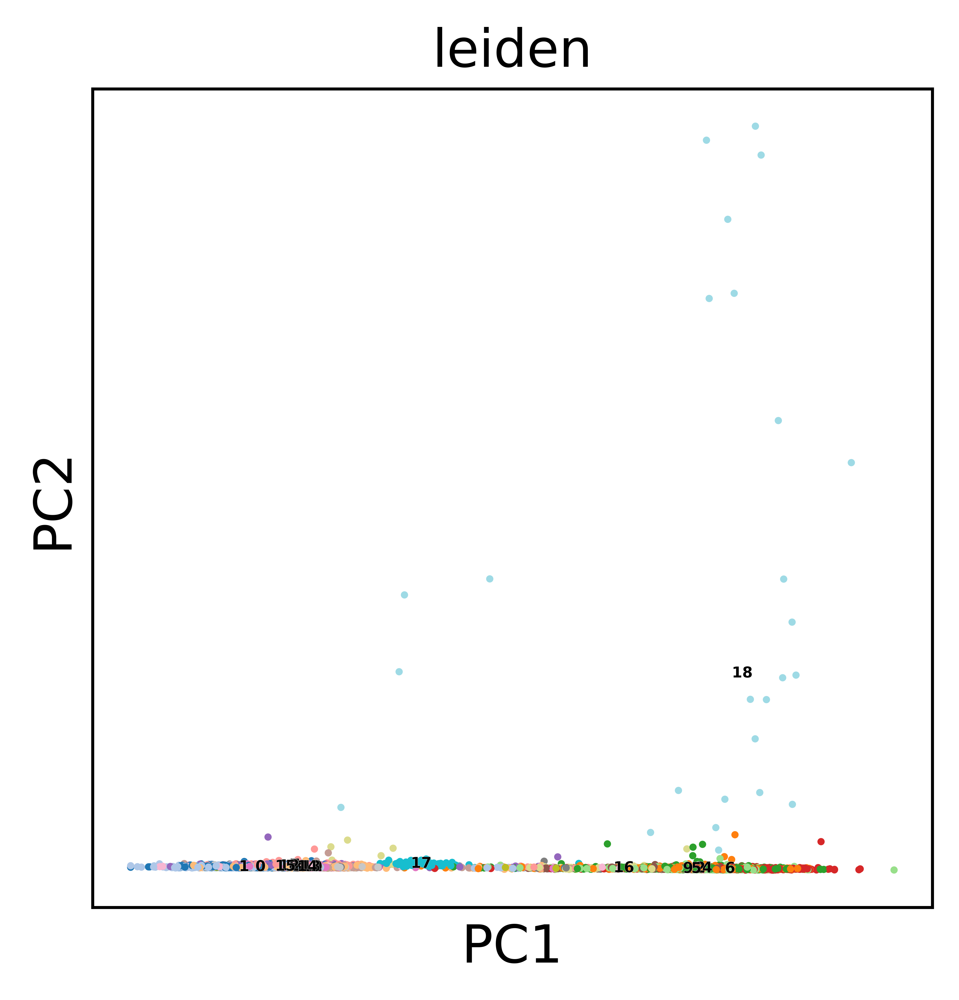

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   32.3s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   38.3s
[Parallel(n_jobs=-1)]: Done 1889 out of 2000 | elapsed:   44.0s remaining:    2.6s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   44.8s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   32.3s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   42.2s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   50.8s finished


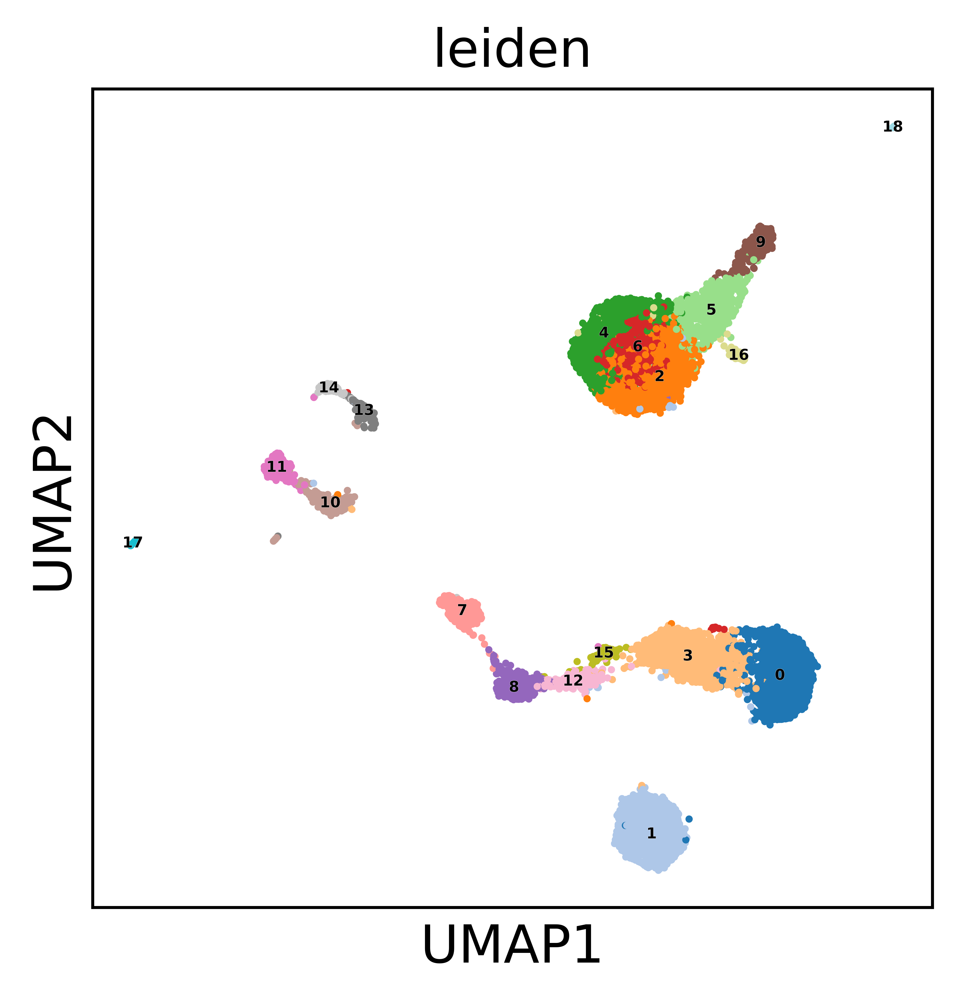

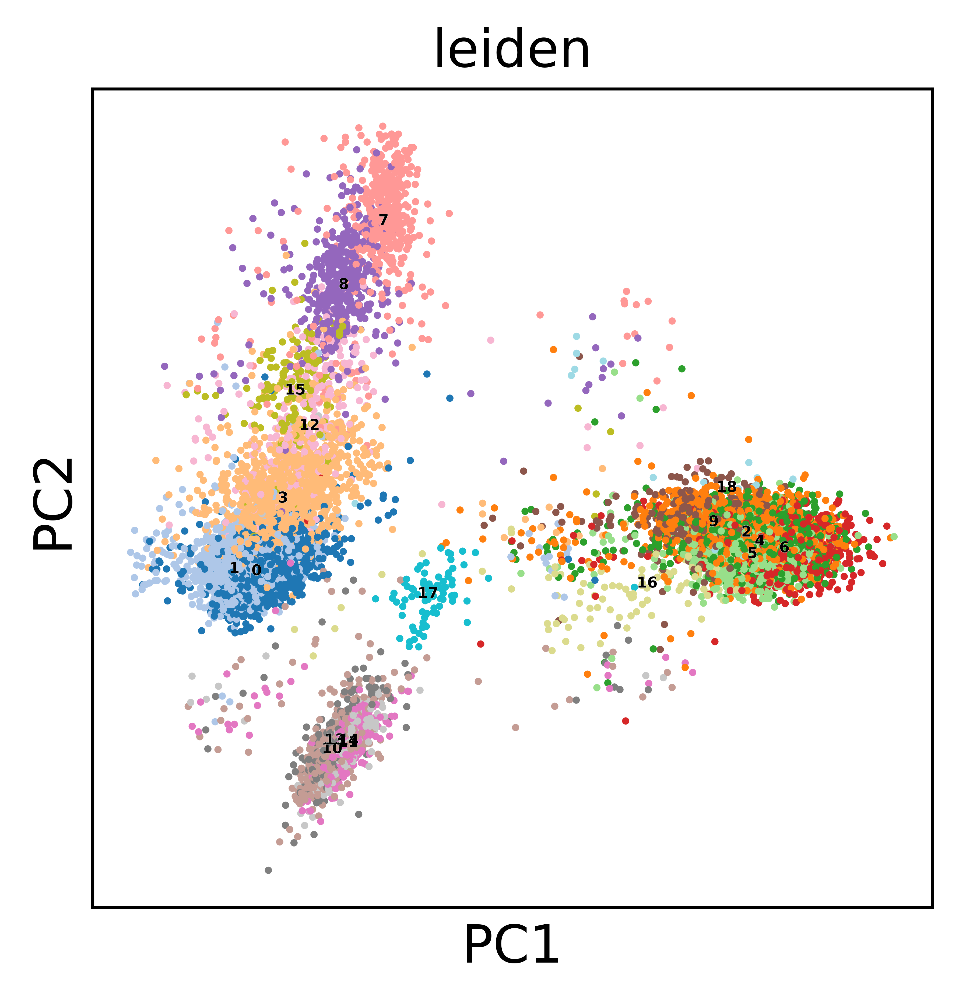

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   32.2s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   38.1s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   44.7s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   31.0s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   39.7s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   47.4s finished


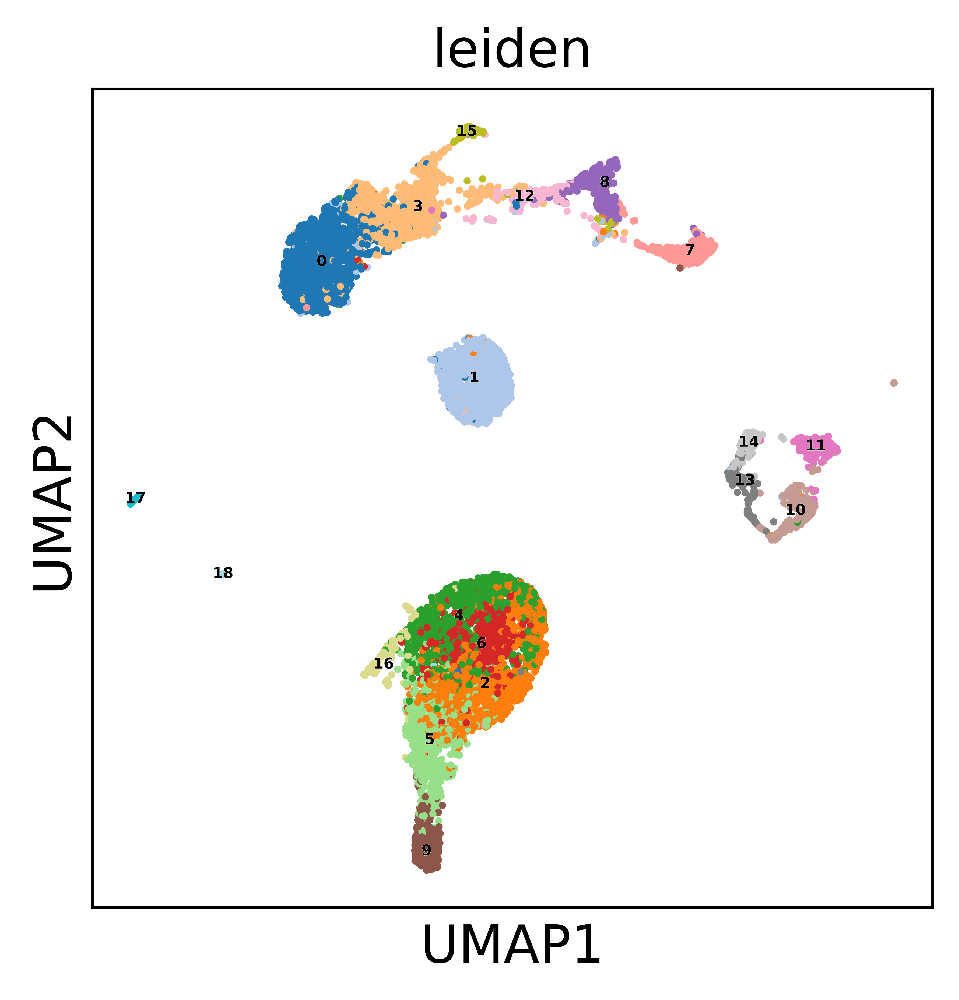

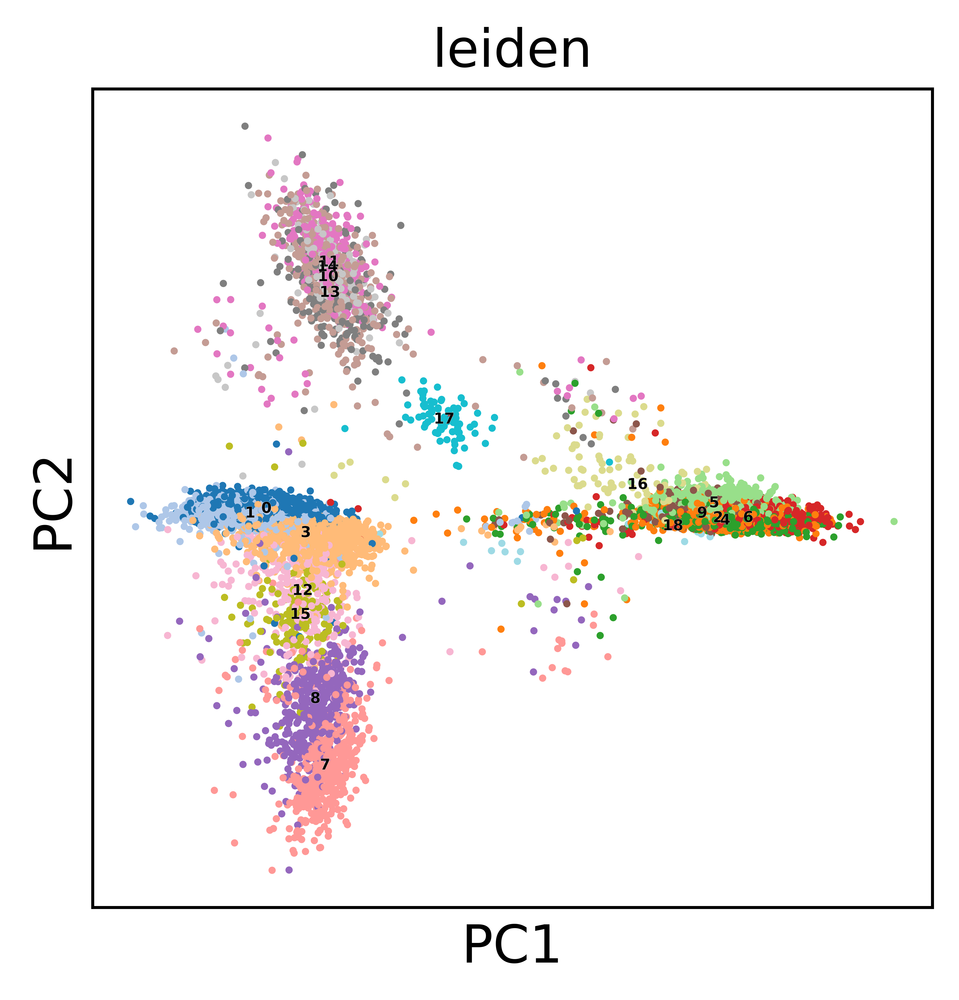

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   31.8s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   37.7s
[Parallel(n_jobs=-1)]: Done 1889 out of 2000 | elapsed:   43.4s remaining:    2.5s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   44.1s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   32.5s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   42.5s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   51.1s finished


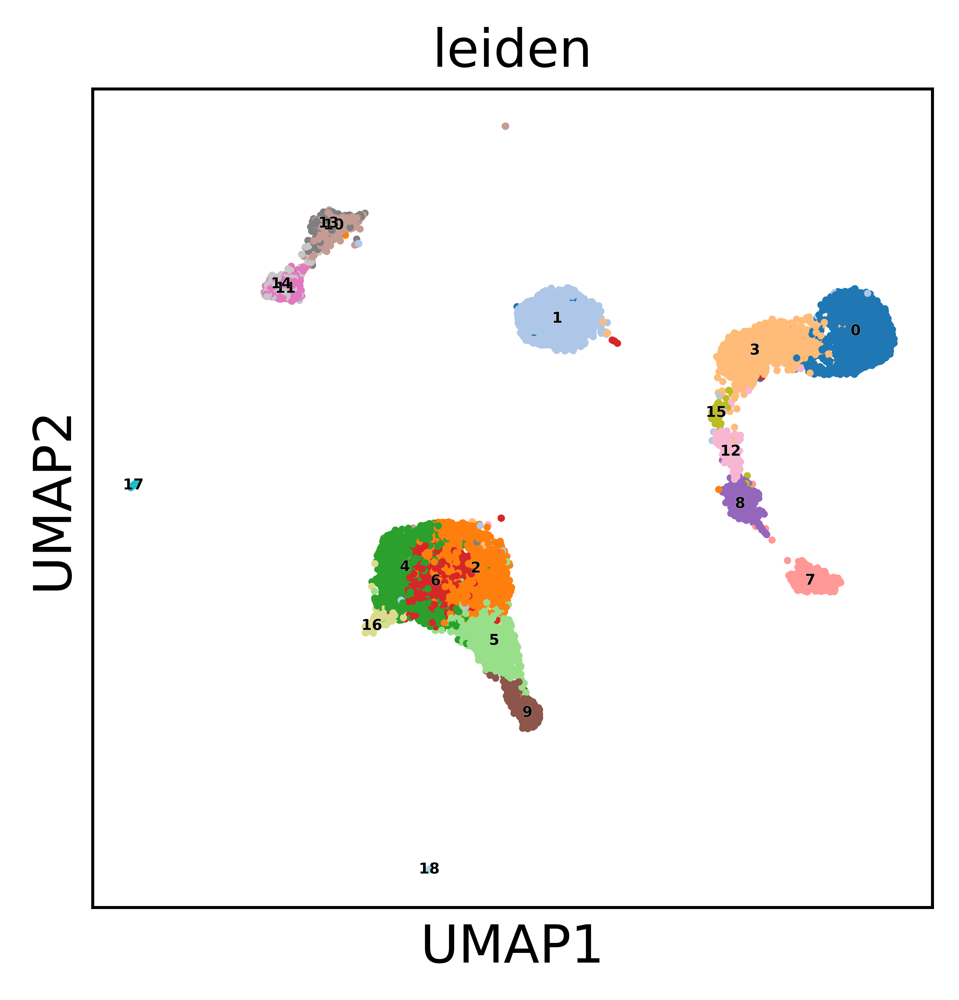

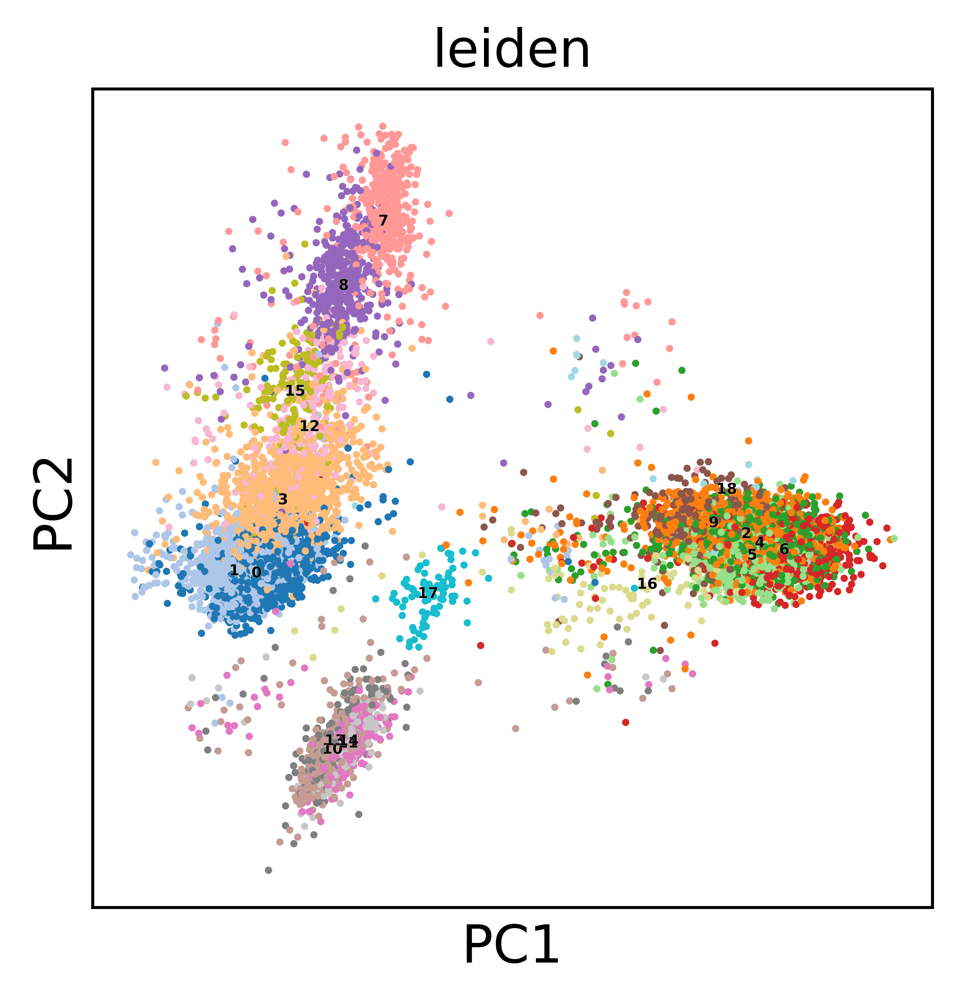

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   32.8s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   38.8s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   45.2s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   31.2s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   39.9s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   47.5s finished


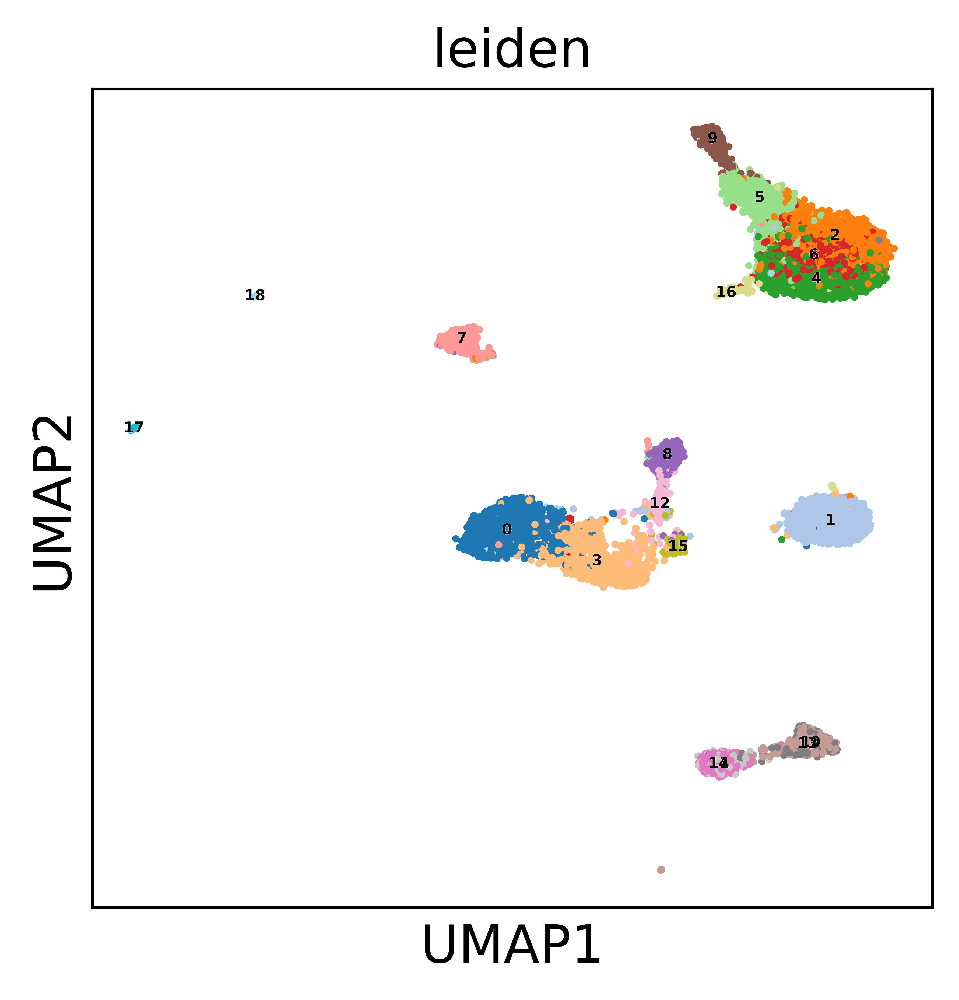

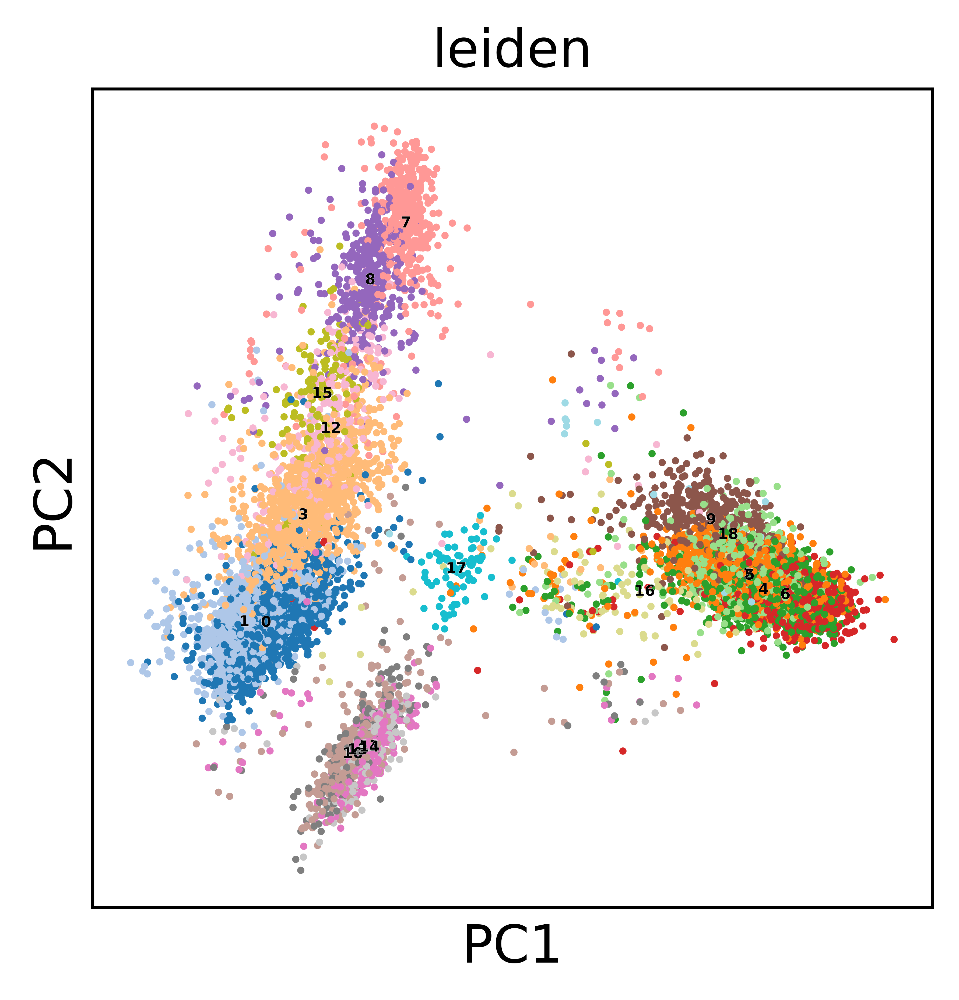

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   32.2s
[Parallel(n_jobs=-1)]: Done 1126 tasks      | elapsed:   38.1s
[Parallel(n_jobs=-1)]: Done 2000 out of 2000 | elapsed:   44.6s finished
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 56 concurrent workers.
[Parallel(n_jobs=-1)]: Done 3456 tasks      | elapsed:   31.4s
[Parallel(n_jobs=-1)]: Done 12956 tasks      | elapsed:   41.5s
[Parallel(n_jobs=-1)]: Done 21890 out of 21890 | elapsed:   50.1s finished


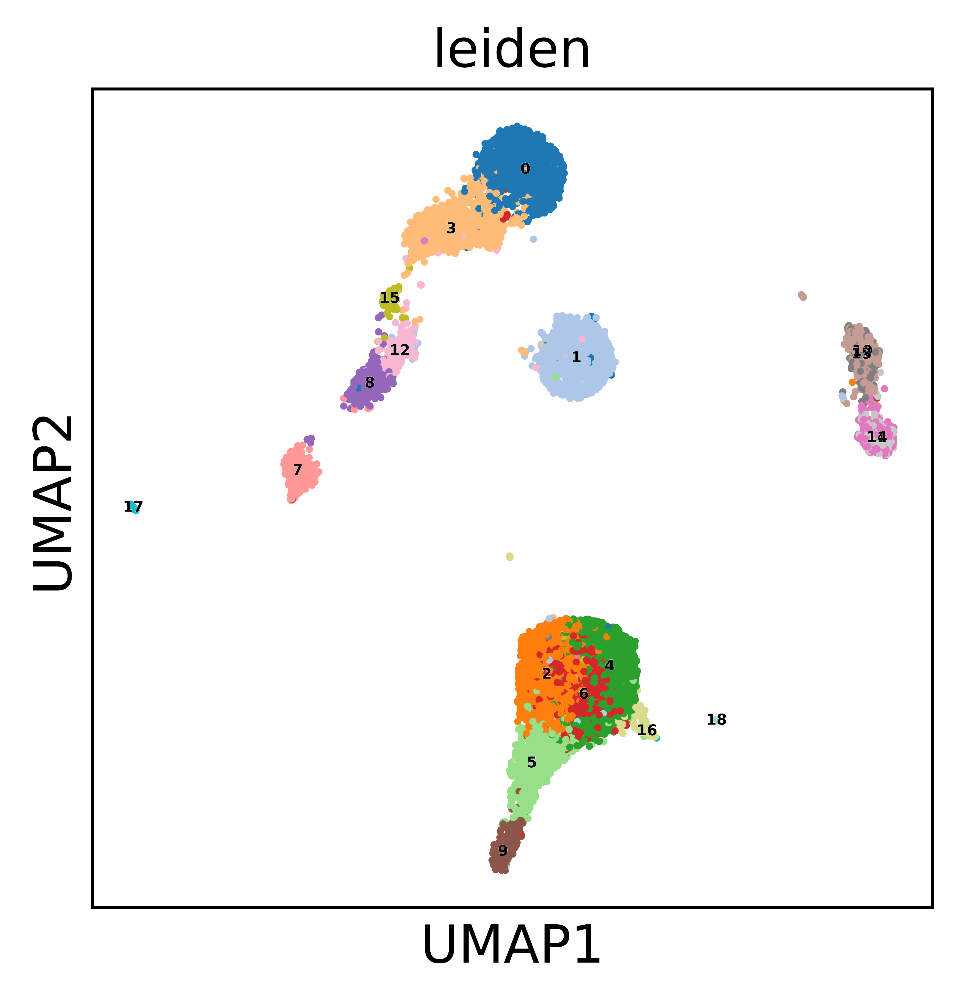

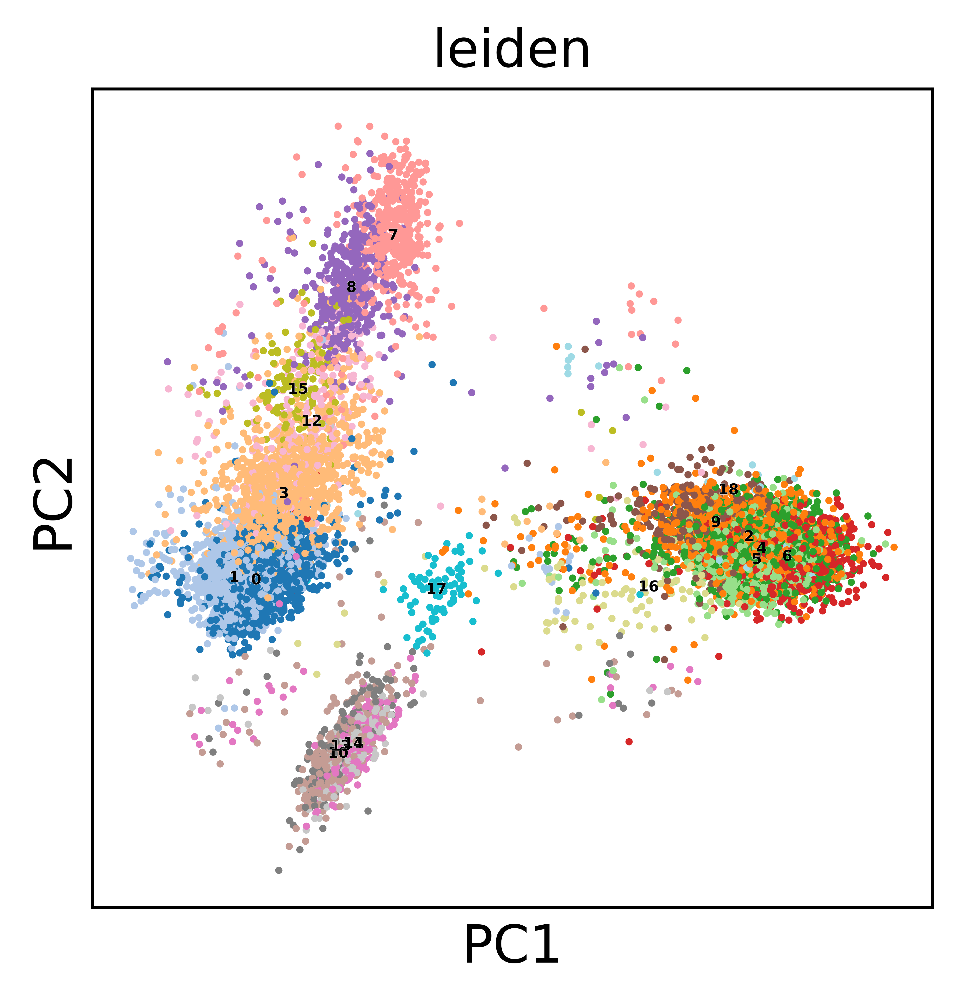

In [79]:
clip = [np.inf, np.sqrt(len(dataset)), np.sqrt(len(dataset)/30), 3.0]
res = ["pearson", "anscombe"]
for c in clip:
    for r in res:
        muffin.tools.compute_residuals(dataset, residuals=r, clip=c, plot=False)
        hv = muffin.tools.feature_selection_elbow(dataset, plot=False)
        muffin.tools.compute_pa_pca(dataset, feature_mask=hv, max_rank=100, plot=False)
        muffin.tools.compute_umap(dataset)
        # Append cell type info to the dataset
        sc.pl.umap(dataset, color='leiden', legend_loc='on data',
                        legend_fontsize=4, legend_fontoutline=0.1, s=15.0,
                        palette='tab20', save=f"umap_{c}_{r}.pdf")
        sc.pl.pca(dataset, color='leiden', legend_loc='on data',
                        legend_fontsize=4, legend_fontoutline=0.1, s=15.0,
                        palette='tab20', save=f"pca_{c}_{r}.pdf")